# Simulation d'une cavité carrée avec les plans de symétrie (XZ) et (YZ), la postion du carré : Rotation 45 degré 

In [1]:
import meep as mp
import matplotlib.pyplot as plt
import numpy as np
import copy

mp.quiet(True)

In [2]:
# Initialized parameter 

b = 1          # base of the square (On peut prend l'unité) 10 pixel 
pml = 0.02     # the thickness of pml layer
pad = 0.03     # the padding between the cavity and the pml layer
n = 1.5        # refractive index the cavity (used resin)
resolution = 200
len_scale = 25

sxy = b*np.sqrt(2) + 2*pml + 2*pad
cell_size = mp.Vector3(sxy, sxy, 0)

# Booudary conditions (using perfect matched layer)
boudary_layer = mp.PML(pml)

# Geometry of the cavity (rotated 45 degree)
geometry = [mp.Block(mp.Vector3(b,b,mp.inf),
                     mp.Vector3(1,1,0), 
                     mp.Vector3(1,-1,0),
                     center=mp.Vector3(),
                     material=mp.Medium(index=n))]

# Injected sources
wl = 4                       # wavelenght in micrometer / in vaccum        
fcen = len_scale/wl          # pulse center frequency
df = 20                      # pulse frequency width

pos_x = 0.25
pos_y = 0.41
src_centers = [mp.Vector3(-pos_x,pos_y), mp.Vector3(pos_x,pos_y), 
               mp.Vector3(pos_x,-pos_y), mp.Vector3(-pos_x,-pos_y)]
src_size = mp.Vector3(0)
src_amps = [1,-1,-1,1]
src_compt = mp.Ez

src = [mp.Source(mp.GaussianSource(fcen, fwidth=df), src_compt, src_centers[0], src_size, src_amps[0]),
       mp.Source(mp.GaussianSource(fcen, fwidth=df), src_compt, src_centers[1], src_size, src_amps[1]),
       mp.Source(mp.GaussianSource(fcen, fwidth=df), src_compt, src_centers[2], src_size, src_amps[2]),
       mp.Source(mp.GaussianSource(fcen, fwidth=df), src_compt, src_centers[3], src_size, src_amps[3])]
#Simulation
sim = mp.Simulation(cell_size= cell_size,
                    geometry= geometry,
                    sources=src,
                    symmetries=[mp.Mirror(mp.X, phase = -1), mp.Mirror(mp.Y)],
                    resolution=resolution,                    
                    boundary_layers=[boudary_layer])

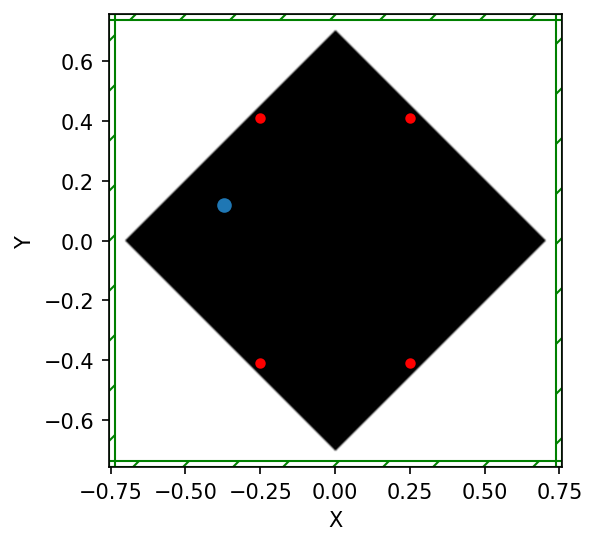

In [3]:
# visualize the cavity
f = plt.figure(dpi=150)
sim.plot2D(ax = f.gca())
x0 = [-0.37]
y0 = [0.12]
plt.plot(x0, y0, "o")
plt.show()

In [4]:
# define step function to collect field Ez
def append_fields(sim):
    box = mp.Volume(center=pt_observed, size=mp.Vector3(0,0))
    ez_fields.append(sim.get_array(vol=box, component=mp.Ez))
    

In [5]:
ez_fields = []
pt_observed = mp.Vector3(-0.37,0.12)

sim.reset_meep()

sim.run(mp.after_sources(append_fields),
        until_after_sources=250)

FloatProgress(value=0.0, description='0% done ', max=250.5)

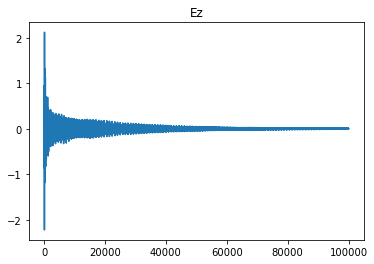

In [6]:
ez0 = ez_fields.copy()
plt.figure()
plt.plot(ez0)
plt.title('Ez')
plt.show()

In [8]:
np.savez('data/Ez_mixed_t250', np.array(ez0))

# Profil de modes de résonance

<IPython.core.display.Javascript object>


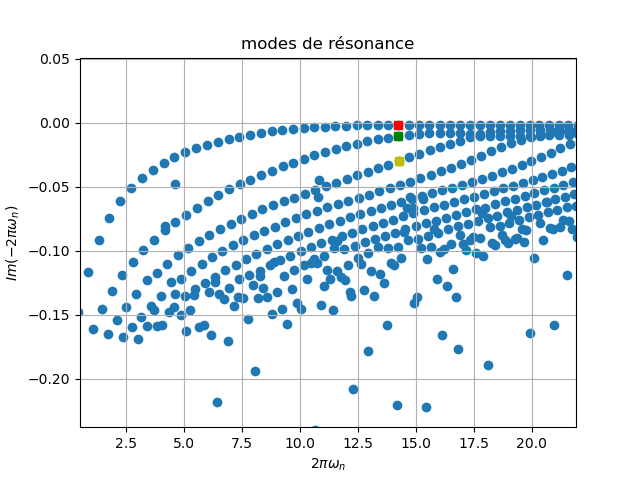

In [11]:
%matplotlib notebook
path = "/home/hong/Desktop/Microlaser1/data/"
file = "modes_Ez_mixed.npz"
npzfile = np.load(path + file)
modes = npzfile['arr_0']

plt.figure()
plt.scatter(modes[:,1], -modes[:,1]/2/modes[:,0])
plt.xlabel('$2\pi \omega_n$')
plt.ylabel('$Im(-2 \pi \omega_n)$')
plt.grid()
plt.title('modes de résonance')
x1 = [1.42423743e+01]
y1 = [-1.42423743e+01/2/4.75829261e+03 ]

x2 = [1.42478841e+01]
y2 = [-1.42478841e+01/2/6.80704538e+02]

x3 = [1.42612746e+01]
y3 = [-1.42612746e+01/2/2.37503253e+02]
plt.plot(x1, y1, "rs", x2, y2, "gs", x3,y3,"ys")
plt.show()

In [10]:
print(modes[(modes[:,1] > 14) 
            & (modes[:,1] < 14.5) 
            #& (modes[:,0]>100)
           ])

[[ 3.20482912e+01  1.41645478e+01  1.12508036e-04 -2.44833205e+00]
 [ 6.31039678e+01  1.40703295e+01  2.04257334e-05 -2.77242215e+00]
 [ 6.78896727e+01  1.43513140e+01  4.51645991e-05  3.64931583e-01]
 [ 7.31963181e+01  1.42240767e+01  5.15966662e-05  2.88018107e+00]
 [ 8.20721263e+01  1.41116108e+01  4.36567386e-05 -2.54418232e+00]
 [ 8.48387375e+01  1.44731743e+01  1.10692821e-06  3.00833026e+00]
 [ 9.24945055e+01  1.40143000e+01  1.00981783e-04  2.95270237e+00]
 [ 9.86315933e+01  1.44545994e+01  1.55827408e-05 -3.02426827e+00]
 [ 1.16271675e+02  1.43739237e+01  1.77031640e-04 -1.06258093e+00]
 [ 1.46789772e+02  1.43080653e+01  2.31647712e-04 -2.18096062e+00]
 [ 2.37503253e+02  1.42612746e+01  2.75678297e-04  3.03944966e+00]
 [ 6.80704538e+02  1.42478841e+01  1.73710134e-03 -7.96526235e-01]
 [ 4.75829261e+03  1.42423743e+01  6.94093904e-03  1.09031688e+00]]


# Méthode pour répéter

In [12]:
def run_mode(fcen, df, until) :
    # overwrite parameter of simulation
    fcen = fcen
    df = df
    src = [mp.Source(mp.GaussianSource(fcen, fwidth=df), src_compt, src_centers[0], src_size, src_amps[0]),
           mp.Source(mp.GaussianSource(fcen, fwidth=df), src_compt, src_centers[1], src_size, src_amps[1]),
           mp.Source(mp.GaussianSource(fcen, fwidth=df), src_compt, src_centers[2], src_size, src_amps[2]),
           mp.Source(mp.GaussianSource(fcen, fwidth=df), src_compt, src_centers[3], src_size, src_amps[3])]

    sim.reset_meep()       # reset everything
    sim.sources = src

    sim.run(mp.after_time(0, append_fields),
            until_after_sources = until)  # run until steady state

    

## 1. freq = 1.42423743e+01, famille #1

In [13]:
%matplotlib inline

In [14]:
pt_observed = mp.Vector3(-0.28,0.32)  # for function append_fields

In [15]:
ez_fields = []  # reset field
run_mode(fcen = 1.42423743e+01, df = 0.001, until = 100)

FloatProgress(value=0.0, description='0% done ', max=10100.0)

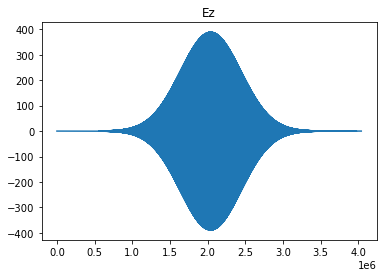

In [16]:
# Plot propagating field
ez1 = ez_fields.copy()
plt.figure()
#plt.axis([0.5,0.6,-17,17])
plt.plot(ez1)
plt.title('Ez')
plt.show()

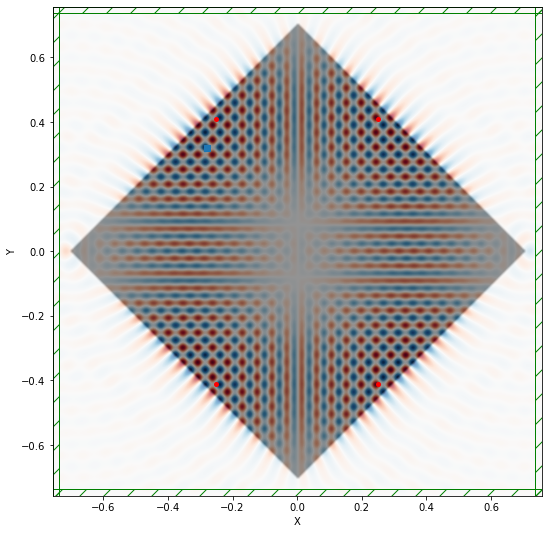

In [21]:
# Plot field Ez in the last instant
plt.figure(figsize=(12,9))
x0 = [-0.28]
y0 = [0.32]
plt.plot(x0, y0, "s")
sim.plot2D(fields = mp.Ez)

In [18]:
freq = 1.42423743e+01
f = plt.figure(dpi=150)
Animate = mp.Animate2D(sim, fields=mp.Ez, f=f, realtime=False, normalize=True)
sim.run(mp.at_every(1/freq/20,Animate),until=1/freq)
plt.close()
Animate.to_jshtml(5)

FloatProgress(value=10100.0, description='0% done ', max=10100.070213012166, min=10100.0)

## 2. freq = 1.42478841e+01, famille #2

In [22]:
ez_fields = []
run_mode(fcen = 1.42478841e+01, df = 0.001, until = 100)

FloatProgress(value=0.0, description='0% done ', max=10100.0)

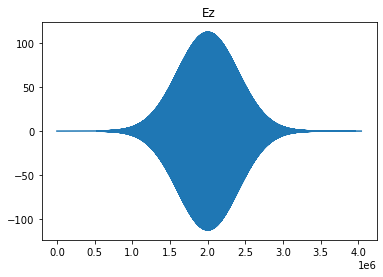

In [23]:
ez2 = ez_fields.copy()
plt.figure()
#plt.axis([0.5,0.6,-17,17])
plt.plot(ez2)
plt.title('Ez')
plt.show()

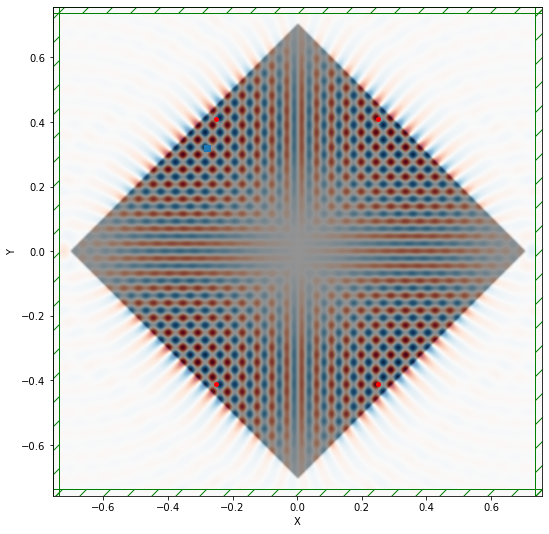

In [24]:
plt.figure(figsize=(12, 9))
x0 = [-0.28]
y0 = [0.32]
plt.plot(x0, y0, "s")
sim.plot2D(fields = mp.Ez)

In [25]:
freq = 1.42478841e+01
f = plt.figure(dpi=150)
Animate = mp.Animate2D(sim, fields=mp.Ez, f=f, realtime=False, normalize=True)
sim.run(mp.at_every(1/freq/20,Animate),until=1/freq)
plt.close()
Animate.to_jshtml(5)

FloatProgress(value=10100.0, description='0% done ', max=10100.070185860088, min=10100.0)

## 3. freq =1.42612746e+01, famille #3

In [26]:
ez_fields = []
run_mode(fcen = 1.42612746e+01, df = 0.005, until = 100)

FloatProgress(value=0.0, description='0% done ', max=2100.0)

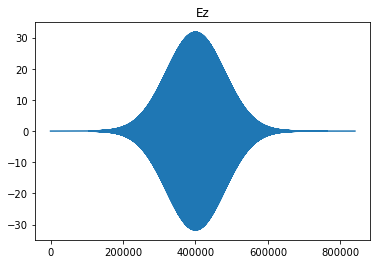

In [27]:
ez3 = ez_fields.copy()
plt.figure()
#plt.axis([0.5,0.6,-17,17])
plt.plot(ez3)
plt.title('Ez')
plt.show()

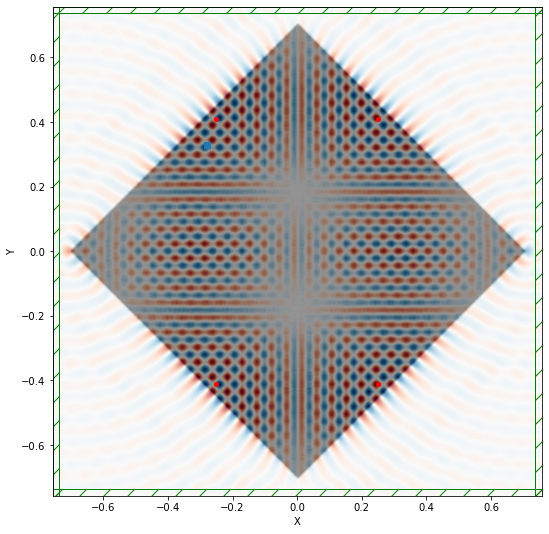

In [30]:
plt.figure(figsize=(12, 9))
x0 = [-0.28]
y0 = [0.33]
plt.plot(x0, y0, "s")
sim.plot2D(fields = mp.Ez)

In [29]:
freq = 1.42612746e+01
f = plt.figure(dpi=150)
Animate = mp.Animate2D(sim, fields=mp.Ez, f=f, realtime=False, normalize=True)
sim.run(mp.at_every(1/freq/20,Animate),until=1/freq)
plt.close()
Animate.to_jshtml(5)

FloatProgress(value=2100.0, description='0% done ', max=2100.0701199596842, min=2100.0)